<h1><center>Clusteranalysis on Creditcard-Dataset </center></h1>






**Import Packages**

In [159]:
from sklearnex import patch_sklearn
patch_sklearn()


Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


In [160]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import contextily as ctx
warnings.simplefilter(action='ignore', category=FutureWarning)
from libpysal.weights import KNN

from sklearn.preprocessing import StandardScaler
from scipy import stats
from scipy.spatial import distance
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from sklearn.cluster import AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph
import geopandas as gpd
import matplotlib.ticker as mticker
from sklearn import metrics
from scipy.cluster import hierarchy
from scipy.sparse import lil_matrix
from matplotlib.colors import ListedColormap
import time

In [161]:
local_crs = 27700
place = "Glasgow"
lat = 55.86421405612109
lng = -4.251846930489373
country = "UK"
crs=4326
radius=100


In [162]:
buildings = gpd.read_parquet(f"../output/{place}/buildings_morphometric_p3.pq")

**Import Data**

**Data Visualization**

## Data Preprocessing

**Dealing with outliers**

The Z-score is the signed number of standard deviations by which the value of an observation or data point is above the mean value of what is being observed or measured.

Or simply take the log of right-skewed variables to ensure good clustering results.

**Standardize data**

In [163]:
df_a = gpd.read_parquet(f"../output/{place}/df_pca_geom.pq")
df = df_a.drop(columns=["row", "col"])

In [164]:
df = df.reset_index(drop=True)

In [165]:
type(df)

geopandas.geodataframe.GeoDataFrame

In [166]:
tess = df

In [167]:
# # Standardise the contextual characters
# cont_std = StandardScaler().fit_transform(df)
# cont_std = pd.DataFrame(cont_std, columns=df.columns)

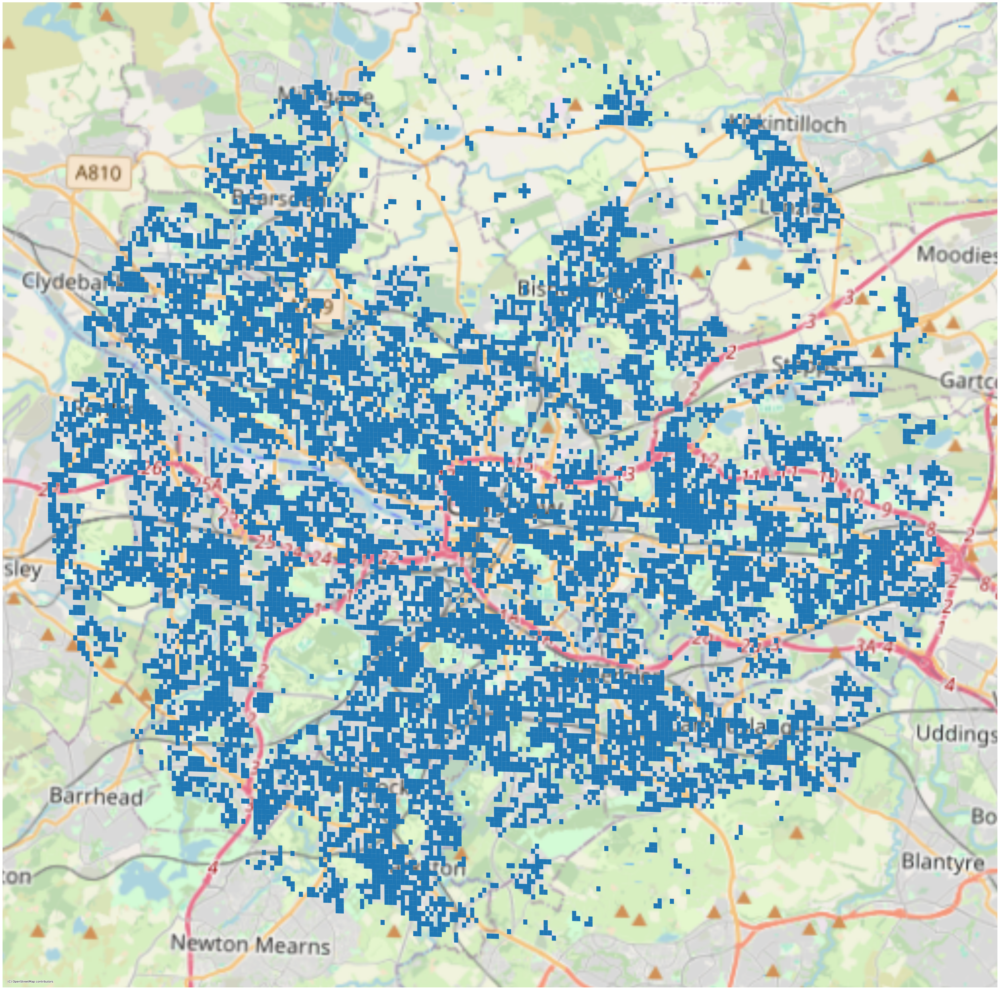

In [168]:
# Create a single subplot
fig, ax = plt.subplots(figsize=(50, 50))  # You can adjust the figure size

# Plotting the GeoDataFrame
df.plot(ax=ax)

# Adding a basemap
ctx.add_basemap(ax, crs=tess.crs.to_string(), source=ctx.providers.OpenStreetMap.Mapnik)

# Removing axis
ax.set_axis_off()
# Display the plot
plt.show()

In [169]:
cont_std = df.drop(columns="geometry")

In [170]:
tess = tess.dropna()

In [209]:
# Build spatial matrix. We tried different methods and KNN seems the best so far.
n=1
w = KNN.from_dataframe(tess, k=n)

c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2635 disconnected components.
  warnings.warn(message)


In [210]:
# # Number of polygons
# n = len(tess)

# # Create a LIL sparse matrix (good for incremental construction)
# sparse_matrix = lil_matrix((n, n), dtype=int)

# # Create spatial index
# sindex = tess.sindex

# # Calculate adjacency using spatial index
# for i, poly1 in enumerate(tess.geometry):
#     # Potential neighbors index
#     possible_neighbors_index = list(sindex.intersection(poly1.bounds))

#     for j in possible_neighbors_index:
#         if i != j:
#             poly2 = tess.geometry.iloc[j]
#             if poly1.touches(poly2):
#                 sparse_matrix[i, j] = 1

# # Convert to a more efficient format like CSR
# sparse_matrix = sparse_matrix.tocsr()

In [211]:
# Test different number of clusters/urban types (between 2 and 11)
cont_std_ = cont_std.copy()
K = range(5,30) 
s = {}
db = {}

In [212]:
%%time
for k in K:
    start_time = time.time()  # Start timing
    
    s[k] = []
    db[k] = []
    
    np.random.seed(123456)  # for reproducibility
    model = AgglomerativeClustering(linkage='ward', connectivity=w.sparse, n_clusters=k)
    y = model.fit(cont_std)
    cont_std_['AHC_k'+ str(k)] = y.labels_
    
    silhouette_score = metrics.silhouette_score(cont_std, y.labels_, metric='euclidean')
    print('silhouette at k=' + str(k) + ': ' + str(silhouette_score))
    s[k].append(silhouette_score)
    
    davies_bouldin_score = metrics.davies_bouldin_score(cont_std, y.labels_)
    print(f'davies bouldin at k={k}: {davies_bouldin_score}')
    db[k].append(davies_bouldin_score)
    
    end_time = time.time()  # End timing
    print(f"Time for k={k}: {end_time - start_time} seconds")  # Print the duration for the cycle

c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=5: 0.10822106103950427
davies bouldin at k=5: 1.861326833493461
Time for k=5: 974.8800523281097 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=6: 0.11927543256038882
davies bouldin at k=6: 1.7552689184831154
Time for k=6: 975.9621114730835 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=7: 0.11185253910910924
davies bouldin at k=7: 1.8101742787389603
Time for k=7: 980.4094505310059 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=8: 0.07336931243487242
davies bouldin at k=8: 2.0007493984750524
Time for k=8: 982.1474983692169 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=9: 0.07114655159199867
davies bouldin at k=9: 1.7813447666706463
Time for k=9: 969.9742195606232 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=10: 0.0753393480014138
davies bouldin at k=10: 1.7943298684482503
Time for k=10: 972.9142551422119 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=11: 0.042114136569261884
davies bouldin at k=11: 1.959976636111447
Time for k=11: 972.4479105472565 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=12: 0.04359135176189594
davies bouldin at k=12: 1.9714420828300678
Time for k=12: 972.5689353942871 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=13: 0.04602151110007784
davies bouldin at k=13: 1.8781636370041246
Time for k=13: 972.1272044181824 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=14: 0.040175982051270154
davies bouldin at k=14: 1.869901624475215
Time for k=14: 973.7022404670715 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=15: 0.044870199720229986
davies bouldin at k=15: 1.9034949747735546
Time for k=15: 973.4667627811432 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=16: 0.03689101358200796
davies bouldin at k=16: 1.913712322549356
Time for k=16: 978.2453699111938 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=17: 0.0364156476436292
davies bouldin at k=17: 1.9324887976514926
Time for k=17: 974.7600455284119 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=18: 0.03946805020223912
davies bouldin at k=18: 1.9524197440899838
Time for k=18: 974.5840609073639 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=19: 0.03489229200365345
davies bouldin at k=19: 2.0825414409270975
Time for k=19: 976.8610422611237 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=20: 0.0372577706821057
davies bouldin at k=20: 2.067549907697483
Time for k=20: 974.1370620727539 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=21: 0.03921074161545797
davies bouldin at k=21: 2.022878278699435
Time for k=21: 974.7859325408936 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=22: 0.026546939691135748
davies bouldin at k=22: 1.9926424437365748
Time for k=22: 974.9007251262665 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=23: 0.02852746771686502
davies bouldin at k=23: 1.9900043871523616
Time for k=23: 975.3830327987671 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=24: 0.030552194559034
davies bouldin at k=24: 1.973509366167022
Time for k=24: 974.34508228302 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=25: 0.030484507171883647
davies bouldin at k=25: 1.8994102698934756
Time for k=25: 980.6651883125305 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=26: 0.02954508493442707
davies bouldin at k=26: 1.9031984679827367
Time for k=26: 974.9200575351715 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=27: 0.031064145815146087
davies bouldin at k=27: 1.8882138674524616
Time for k=27: 971.7497246265411 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=28: 0.024732557347206988
davies bouldin at k=28: 1.916609730892295
Time for k=28: 971.841459274292 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 2635 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=29: 0.02575754234262951
davies bouldin at k=29: 1.9305656696251658
Time for k=29: 971.871616601944 seconds
CPU times: total: 1d 5h 36min 31s
Wall time: 6h 46min 9s


In [219]:
# Create the silhouette diagram  
vals = []
clus = []

for c, v in s.items():
    vals += v
    clus += [c]

In [220]:
silhouettes = pd.DataFrame({'n_cluster': clus, 'silhouette': vals})

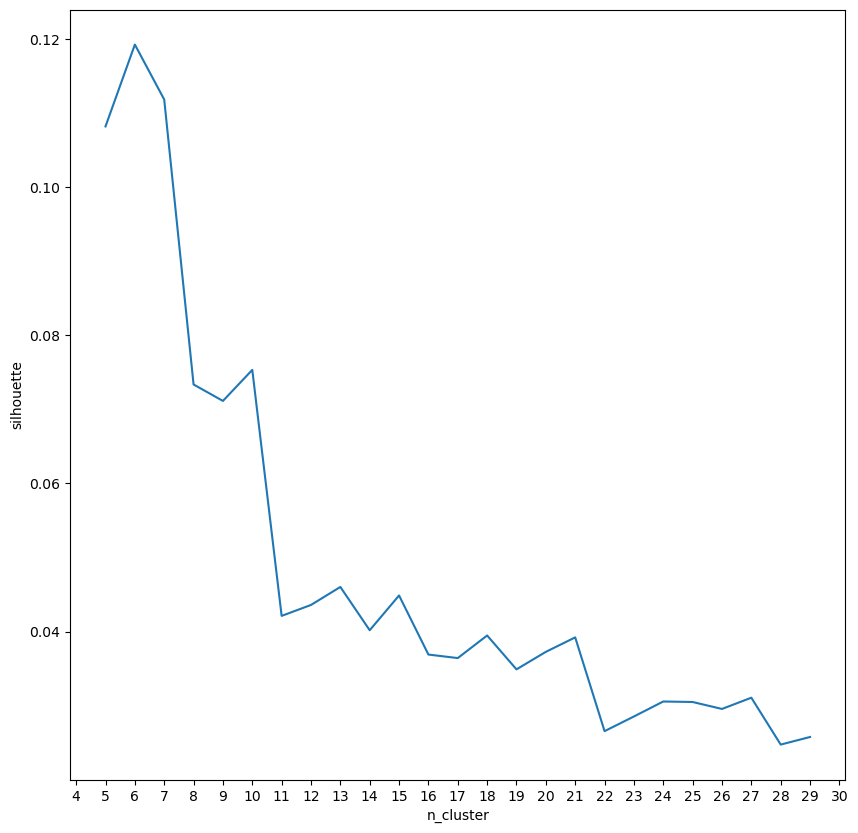

In [221]:
# Plot the silhouette diagram. The best solution is usually a peak before a sudden drop. We would go with 6 in this case.
fig, ax = plt.subplots(figsize=(10, 10))
sns.lineplot(x="n_cluster", y="silhouette", data=silhouettes)
plt.ticklabel_format(style='plain')
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
plt.show()

In [222]:
# Create the silhouette diagram  
vals_db = []
clus_db = []

for c, v in db.items():
    vals_db += v
    clus_db += [c]

In [223]:
davies_bouldin = pd.DataFrame({'n_cluster': clus_db, 'davies_bouldin': vals_db})

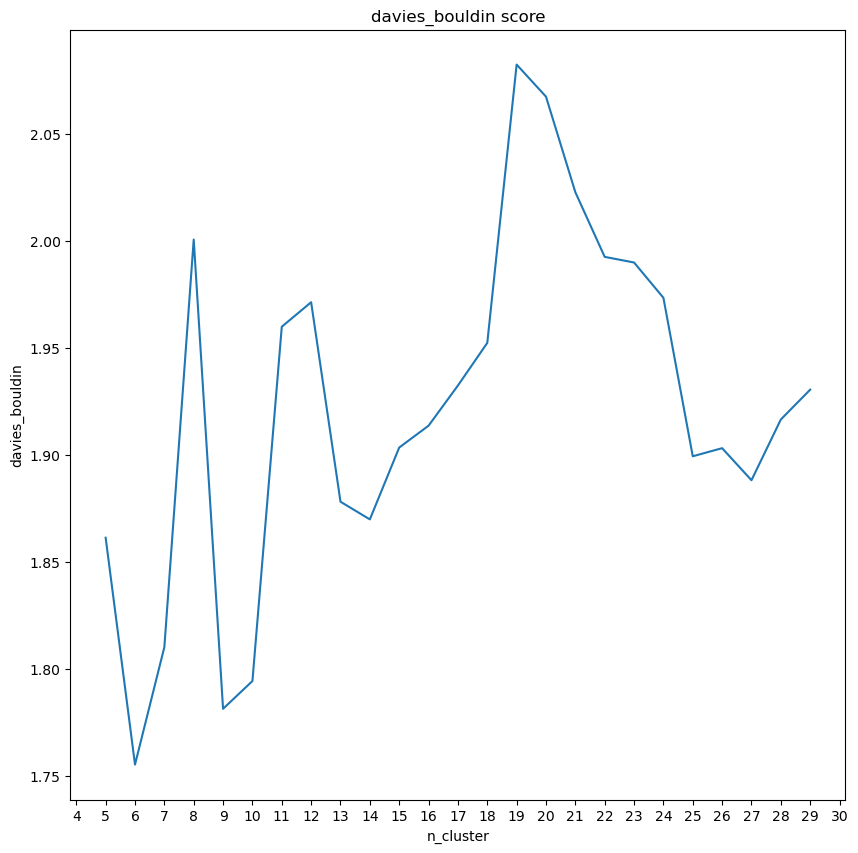

In [224]:
# Plot the silhouette diagram. The best solution is usually a peak before a sudden drop. We would go with 6 in this case.
fig, ax = plt.subplots(figsize=(10, 10))
sns.lineplot(x="n_cluster", y="davies_bouldin", data=davies_bouldin)
plt.ticklabel_format(style='plain')
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
plt.title(f"davies_bouldin score")
plt.savefig(f"../output/{place}/davies_bouldin.jpg")
plt.show()

In [225]:
# rejoin geometries to the dataframe to be able to map results
cont_std_ = cont_std_.join(tess[['geometry']])
cont_std_ = gpd.GeoDataFrame(cont_std_, geometry=cont_std_['geometry'])

In [226]:
cont_std_

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,...,AHC_k21,AHC_k22,AHC_k23,AHC_k24,AHC_k25,AHC_k26,AHC_k27,AHC_k28,AHC_k29,geometry
0,-47.186208,2.120329,11.931346,-3.895301,2.844737,-1.081926,0.462450,-6.009090,0.181861,3.247890,...,11,11,11,11,11,11,11,11,11,"POLYGON ((259084.263 675109.206, 259173.839 67..."
1,-0.384040,-0.996047,0.914154,-7.114937,1.278495,0.634043,-0.732728,0.737278,0.645171,-2.291317,...,8,8,8,8,8,8,3,3,3,"POLYGON ((261863.396 674683.587, 261952.976 67..."
2,1.534474,0.529546,-1.763989,-1.180721,0.689467,-1.468957,0.182930,0.008183,1.691577,-0.940494,...,18,18,18,18,18,18,8,8,8,"POLYGON ((254878.396 674577.338, 254967.973 67..."
3,0.772152,2.892817,3.870703,-2.600116,0.699332,-1.350347,1.126805,0.793433,1.295206,-2.348206,...,3,3,3,3,3,3,1,0,6,"POLYGON ((261507.324 674359.360, 261596.906 67..."
4,1.659454,1.721584,-1.691558,-2.023369,-0.318357,2.250311,-0.883681,0.411642,-0.941152,-0.749335,...,18,18,18,18,18,18,8,8,8,"POLYGON ((262134.399 674339.263, 262223.981 67..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10811,2.098156,3.241927,-1.097102,0.485086,-1.393753,3.766221,1.645503,0.740889,-2.086707,-1.075284,...,10,4,4,1,0,12,26,26,26,"POLYGON ((255617.406 656552.381, 255707.121 65..."
10812,1.940098,0.322091,0.445988,3.100244,-2.010825,3.940597,0.262862,-3.600830,-2.995534,7.159245,...,5,5,5,5,5,5,5,5,5,"POLYGON ((258219.109 656466.586, 258308.823 65..."
10813,1.302774,1.140060,-0.502776,-1.244469,2.431153,1.641391,0.043814,0.584005,3.587666,-1.347048,...,13,13,13,13,13,6,6,6,2,"POLYGON ((257771.974 656257.800, 257861.690 65..."
10814,0.602889,0.127225,2.017793,-2.552481,3.564246,0.813460,0.595903,0.557309,1.397866,-1.311770,...,18,18,18,18,18,18,8,8,8,"POLYGON ((257862.407 656143.130, 257952.123 65..."


In [228]:

n = 28 # Specify the number of colors you need

In [229]:
out_gdf = gpd.GeoDataFrame(cont_std_, geometry="geometry")

In [230]:
out_gdf.to_parquet(f"../output/{place}/cont_std.pq")

In [231]:
import seaborn as sns

# Function to generate a qualitative color palette
def generate_qualitative_palette(n_colors):
    palette = palette = sns.color_palette("Spectral", n_colors=n_colors)
    return palette

# Example usage
qualitative_palette = generate_qualitative_palette(n)

palette_dict = {}
# Printing the palette
for i, color in enumerate(qualitative_palette):
    palette_dict[i] = color
    
qualitative_palette

[(0.6872741253364091, 0.07896962706651288, 0.2748173779315648),
 (0.7633986928104575, 0.1633986928104575, 0.2928104575163399),
 (0.8376778162245291, 0.2467512495194156, 0.308881199538639),
 (0.8805843906189927, 0.3118031526336025, 0.2922722029988466),
 (0.9234909650134564, 0.3768550557477893, 0.27566320645905423),
 (0.958246828143022, 0.43744713571703187, 0.267358708189158),
 (0.9707035755478662, 0.5274125336409072, 0.3088811995386389),
 (0.9831603229527105, 0.6173779315647827, 0.3504036908881199),
 (0.9925413302575933, 0.7015763168012302, 0.39653979238754317),
 (0.993925413302576, 0.7707804690503652, 0.4546712802768165),
 (0.9953094963475586, 0.8399846212995001, 0.5128027681660899),
 (0.9965397923875433, 0.8927335640138409, 0.5690888119953863),
 (0.9979238754325259, 0.9356401384083044, 0.6410611303344866),
 (0.9993079584775086, 0.9785467128027682, 0.7130334486735871),
 (0.9826989619377164, 0.9930795847750865, 0.7220299884659749),
 (0.9480968858131489, 0.9792387543252595, 0.6680507497116495),
 (0.9134948096885814, 0.9653979238754326, 0.6140715109573243),
 (0.8565936178392929, 0.942329873125721, 0.6053056516724337),
 (0.7749327181853136, 0.9091118800461362, 0.6219146482122261),
 (0.6932718185313343, 0.8758938869665515, 0.6385236447520184),
 (0.60161476355248, 0.8396770472895041, 0.6441368704344483),
 (0.5061130334486736, 0.8023068050749712, 0.6455209534794311),
 (0.4106113033448674, 0.7649365628604383, 0.6469050365244137),
 (0.34402153018069975, 0.6983467896962706, 0.6728950403690889),
 (0.27204921184159936, 0.6180699730872741, 0.7061130334486736),
 (0.20007689350249905, 0.5377931564782776, 0.7393310265282584),
 (0.25359477124183005, 0.45882352941176474, 0.7058823529411765),
 (0.31449442522106885, 0.37993079584775086, 0.6685121107266436)]

In [232]:
palette_dict

{0: (0.6872741253364091, 0.07896962706651288, 0.2748173779315648),
 1: (0.7633986928104575, 0.1633986928104575, 0.2928104575163399),
 2: (0.8376778162245291, 0.2467512495194156, 0.308881199538639),
 3: (0.8805843906189927, 0.3118031526336025, 0.2922722029988466),
 4: (0.9234909650134564, 0.3768550557477893, 0.27566320645905423),
 5: (0.958246828143022, 0.43744713571703187, 0.267358708189158),
 6: (0.9707035755478662, 0.5274125336409072, 0.3088811995386389),
 7: (0.9831603229527105, 0.6173779315647827, 0.3504036908881199),
 8: (0.9925413302575933, 0.7015763168012302, 0.39653979238754317),
 9: (0.993925413302576, 0.7707804690503652, 0.4546712802768165),
 10: (0.9953094963475586, 0.8399846212995001, 0.5128027681660899),
 11: (0.9965397923875433, 0.8927335640138409, 0.5690888119953863),
 12: (0.9979238754325259, 0.9356401384083044, 0.6410611303344866),
 13: (0.9993079584775086, 0.9785467128027682, 0.7130334486735871),
 14: (0.9826989619377164, 0.9930795847750865, 0.7220299884659749),
 15: 

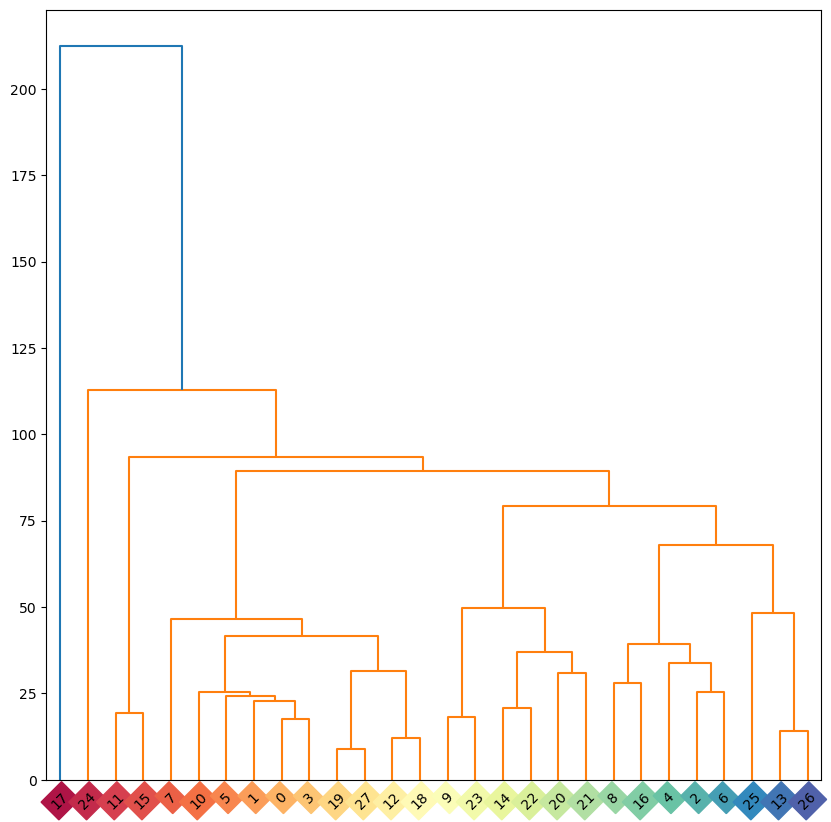

In [233]:
group = out_gdf.drop(columns="geometry").groupby(f'AHC_k{n}').mean()
Z = hierarchy.linkage(group, 'ward')
plt.figure(figsize=(10, 10))
dn = hierarchy.dendrogram(Z, labels=group.index)

# Applying the color palette to the dendrogram
ax = plt.gca()
x_labels = ax.get_xmajorticklabels()
for i, x_label in enumerate(x_labels):
    idx = int(x_label.get_text())
    x_label.set_backgroundcolor(palette_dict[i])

plt.savefig(f"../output/{place}/dendogram.jpg")
plt.show()


In [234]:
mapped_palette_dict = {}
for index, (key, value) in enumerate(palette_dict.items()):
    mapped_palette_dict[dn['leaves'][index]] = palette_dict[key]

In [235]:

# Convert your color dictionary to a list in the correct order
palette = [mapped_palette_dict[i] for i in sorted(mapped_palette_dict)]


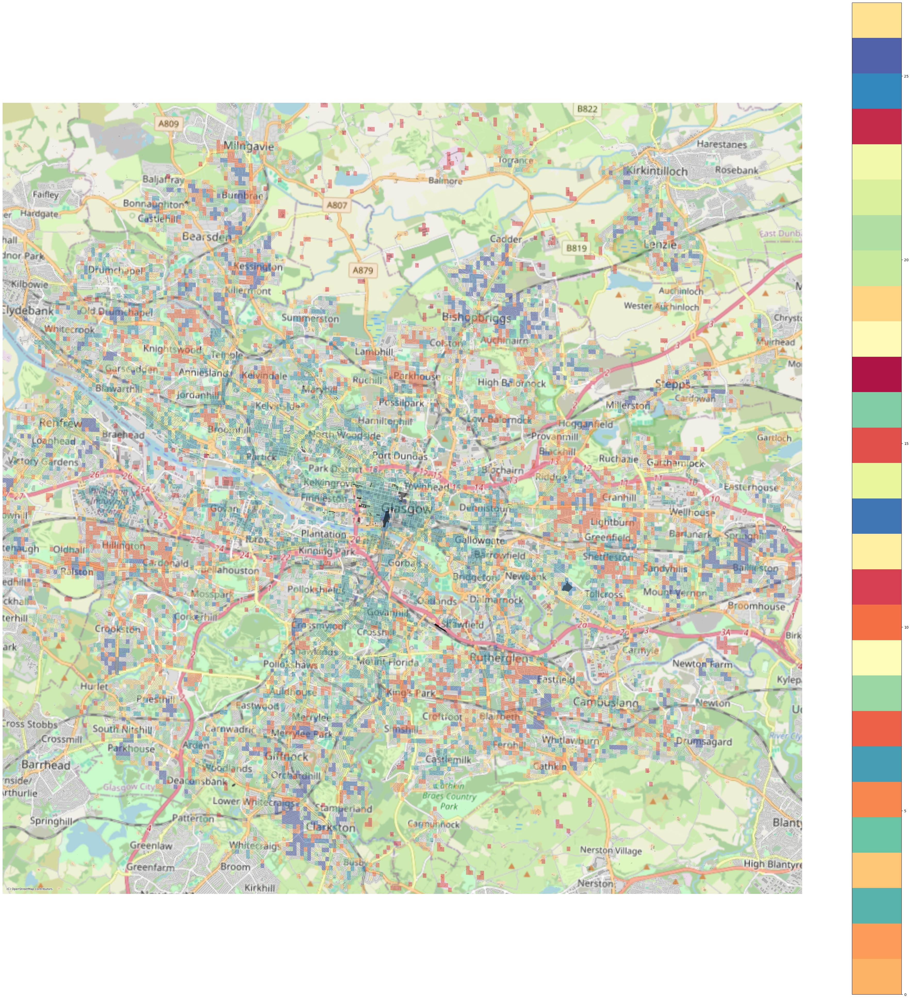

In [237]:
# Create a single subplot
fig, ax = plt.subplots(figsize=(50, 50))  # You can adjust the figure size


# Plotting the GeoDataFrame
out_gdf.plot(column=f'AHC_k{n}', ax=ax, cmap=ListedColormap(palette), legend=True, alpha=0.5)

# Set the limits to the extent of out_gdf
xmin, ymin, xmax, ymax = out_gdf.total_bounds
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

buildings.plot(ax=ax, color='black', edgecolor='none', alpha=0.2)

# Adding a basemap
ctx.add_basemap(ax, crs=out_gdf.crs.to_string(), source=ctx.providers.OpenStreetMap.Mapnik)

# Annotating each polygon with the AHC_k{n} value
for idx, row in out_gdf.iterrows():
    # Calculate the centroid of each polygon
    centroid = row.geometry.centroid
    # Get the AHC_k{n} value for the label
    label = row[f'AHC_k{n}']
    # Place the label at the centroid, adjusting text size and position as needed
    ax.annotate(s=label, xy=(centroid.x, centroid.y), horizontalalignment='center', verticalalignment='center', fontsize=12, color='red')


# Removing axis
ax.set_axis_off()

plt.savefig(f"../output/{place}/plot.jpg")

# Display the plot
plt.show()